# End to End Example
Shows how to use tiling, etc., to infer on an image, run NMS suppression and display results.

In [122]:
%matplotlib inline

from PIL import Image
import numpy as np
import torch
from torchvision.transforms import v2

# image_name = 'images/cars.jpg'
# image_name = 'images/large-sat-image-color.jpg'
image_name = 'images/large-sat-image-docks.png'

Image.MAX_IMAGE_PIXELS = 933120000
image = Image.open(image_name)
resized = image.resize((768, 768))
image_arr = np.array(image)
print("array: ", image_arr.shape, image_arr.dtype, image_arr.size * image_arr.itemsize)

size = 768
overlap = 0.2
stride = int(size * (1 - overlap))
device = (
  "cuda" if torch.cuda.is_available()
  else "mps" if torch.backends.mps.is_built() else "cpu"
)
print('Using', device)

array:  (2069, 1877, 3) uint8 11650539
Using cuda


In [2]:
!pip install torchvision

/usr/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


Defaulting to user installation because normal site-packages is not writeable


In [123]:
from transformers import AutoModelForZeroShotObjectDetection, AutoProcessor, AutoConfig, AutoImageProcessor
from torch.profiler import profile, record_function, ProfilerActivity
import torch

# OwlVit 32 is orders of magnitude faster.
processor = AutoProcessor.from_pretrained("google/owlvit-base-patch32")
model = AutoModelForZeroShotObjectDetection.from_pretrained("google/owlvit-base-patch32")

text_queries = ["satellite photo of a ship"]

In [124]:
from torchvision.transforms import v2

def convert_nhwc_to_nchw(batch):
    return batch.permute(0, 3, 1, 2)

image_mean = [
    0.48145466,
    0.4578275,
    0.40821073
]
image_std = [
    0.26862954,
    0.26130258,
    0.27577711
]
def normalize(batch):
    return v2.functional.normalize(batch, mean=image_mean, std=image_std, inplace=True)

rescale_factor = 0.00392156862745098
def rescale(batch):
    return batch * rescale_factor

In [125]:
%%time

import tiling
import tqdm
import torch
from torchvision.transforms import v2

batch_size = 5

tiles = tiling.tile_image(image_arr, size, size, 0.2)
print('total tiles:', len(tiles))
height, width = tiles[0].tile.shape[:2]
results = []
cuda_image = torch.tensor(image_arr).to(device).detach()
cuda_image = cuda_image.permute(2, 0, 1)
batch_size = 5
tensors = [cuda_image[:, t.y:t.y + height, t.x:t.x + width] for t in tiles]
batches = [tensors[i:i + batch_size] for i in range(0, len(tensors), batch_size)]
inputs = processor(text=text_queries, return_tensors="pt").to(device)
attention_mask = inputs['attention_mask'].repeat(batch_size, 1)
input_ids = inputs['input_ids'].repeat(batch_size, 1)
with torch.no_grad():
    model.to(device)
    for batch in tqdm.tqdm(batches):
        inputs['pixel_values'] = normalize(rescale(torch.stack(batch, 0)))
        inputs['attention_mask'] = attention_mask[:len(batch)]
        inputs['input_ids'] = input_ids[:len(batch)]
        sizes = torch.tensor([size, size]).to(device).repeat(len(batch), 1)
        results.extend(processor.post_process_object_detection(model(**inputs), threshold=0.09, target_sizes=sizes))

total tiles: 12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 10.45it/s]

CPU times: user 442 ms, sys: 11.1 ms, total: 454 ms
Wall time: 372 ms


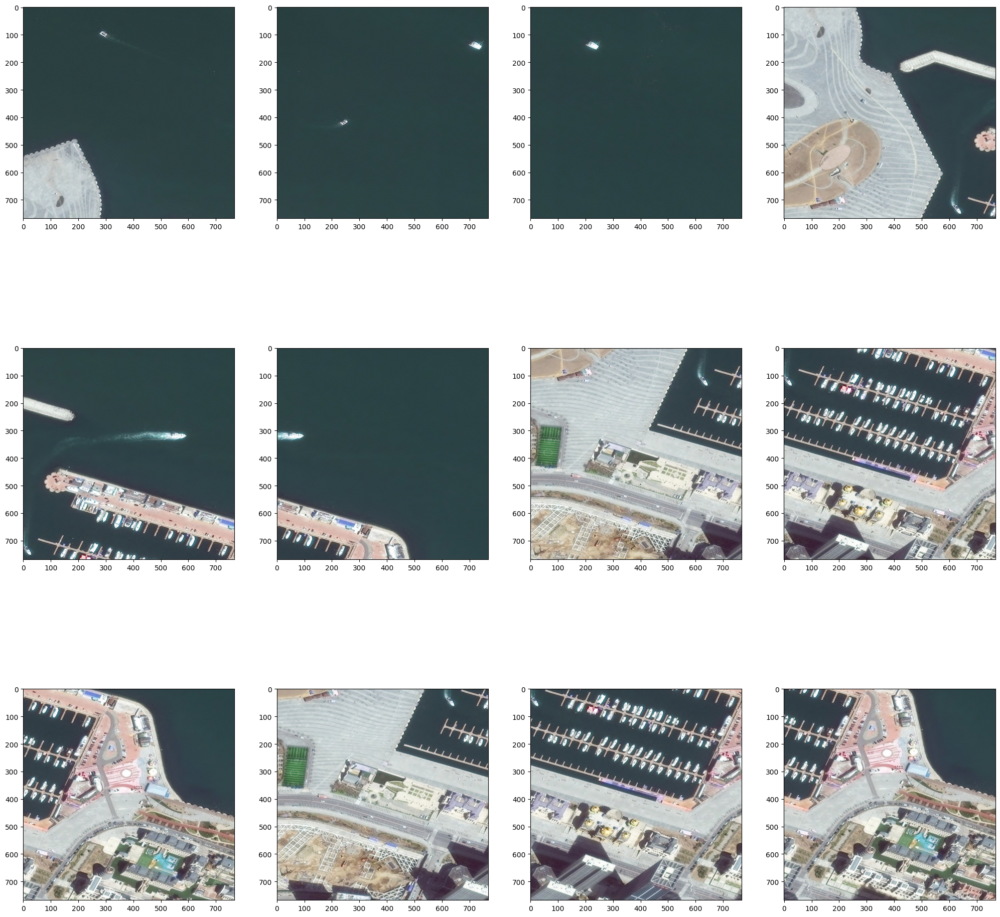

In [109]:
import math
from matplotlib import pyplot as plt

cols = 4
rows = math.ceil(len(tiles) / cols)
f,ax = plt.subplots(rows, cols, figsize=(25, 25))
for idx, tile in enumerate(tiles):
    row = int(idx / cols)
    ax[row, idx % cols].imshow(tile.tile)
plt.show()

tensor([], device='cuda:0', size=(0, 4))
tensor([], device='cuda:0', size=(0, 4))
tensor([], device='cuda:0', size=(0, 4))
tensor([[610.3135, 716.9089, 647.3733, 753.0630]], device='cuda:0')
tensor([[262.8757, 587.0194, 319.2168, 640.8654],
        [ 56.5105, 416.5464, 764.3169, 767.3324],
        [ 51.7562, 681.1525, 394.5097, 768.4532]], device='cuda:0')
tensor([], device='cuda:0', size=(0, 4))
tensor([], device='cuda:0', size=(0, 4))
tensor([], device='cuda:0', size=(0, 4))
tensor([], device='cuda:0', size=(0, 4))
tensor([], device='cuda:0', size=(0, 4))
tensor([], device='cuda:0', size=(0, 4))
tensor([], device='cuda:0', size=(0, 4))


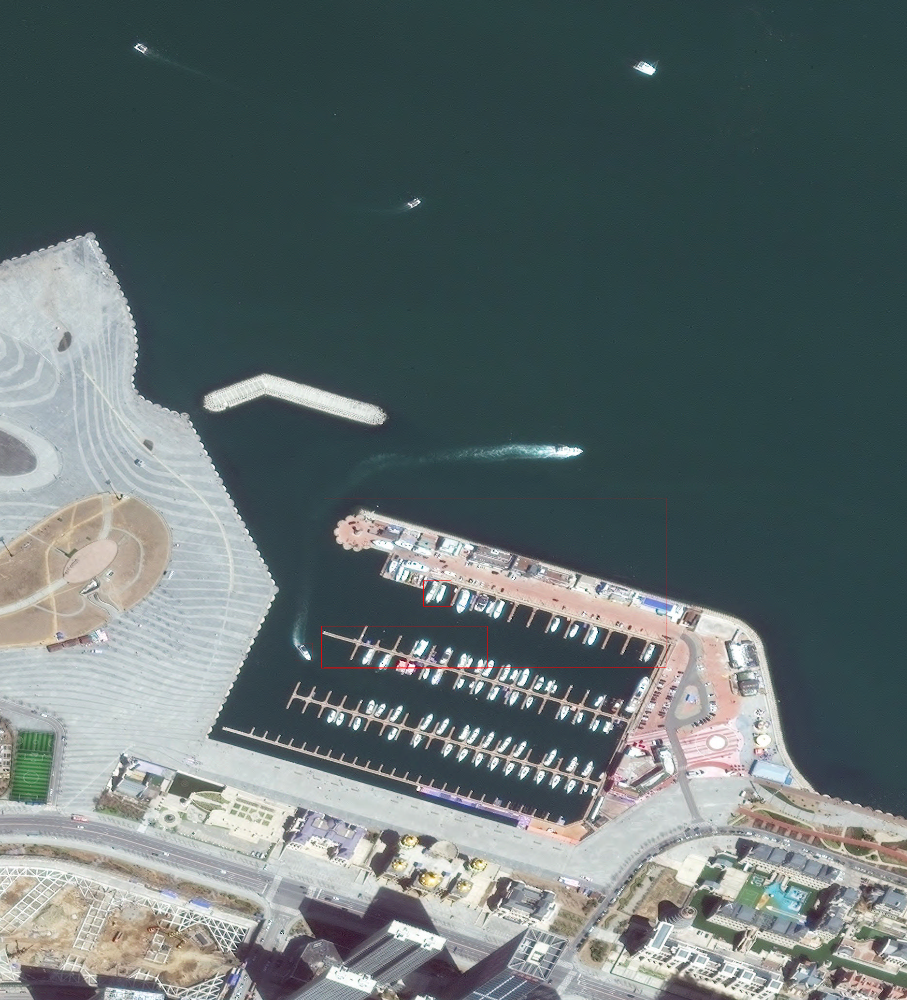

In [127]:
import PIL

image = Image.open(image_name)
draw = PIL.ImageDraw.Draw(image)
for tile, result in zip(tiles, results):
    boxes = result['boxes']
    for i in range(boxes.shape[0]):
        box = boxes[i]
        x1 = int(box[0] + tile.x)
        y1 = int(box[1] + tile.y)
        x2 = int(box[2] + tile.x)
        y2 = int(box[3] + tile.y)
        draw.rectangle((x1, y1, x2, y2), outline="red", width=1)
display(image)

In [103]:
%%time
import torchvision

boxes_to_nms = []
scores_to_nms = []
idxs_to_nms = []
for tile, result in zip(tiles, results):
    boxes = torch.add(result['boxes'].to("cpu"), torch.tensor([tile.x, tile.y, tile.x, tile.y]))
    boxes_to_nms.extend(boxes)
    scores_to_nms.extend(result['scores'].to("cpu"))
    idxs_to_nms.extend(torch.tensor([0] * boxes.shape[0]))
stacked_boxes = torch.stack(boxes_to_nms, 0)
stacked_scores = torch.stack(scores_to_nms, 0)
stacked_indices = torch.stack(idxs_to_nms, 0)
kept = torchvision.ops.batched_nms(stacked_boxes, stacked_scores, stacked_indices, 0.5)


CPU times: user 3.49 ms, sys: 0 ns, total: 3.49 ms
Wall time: 2.89 ms


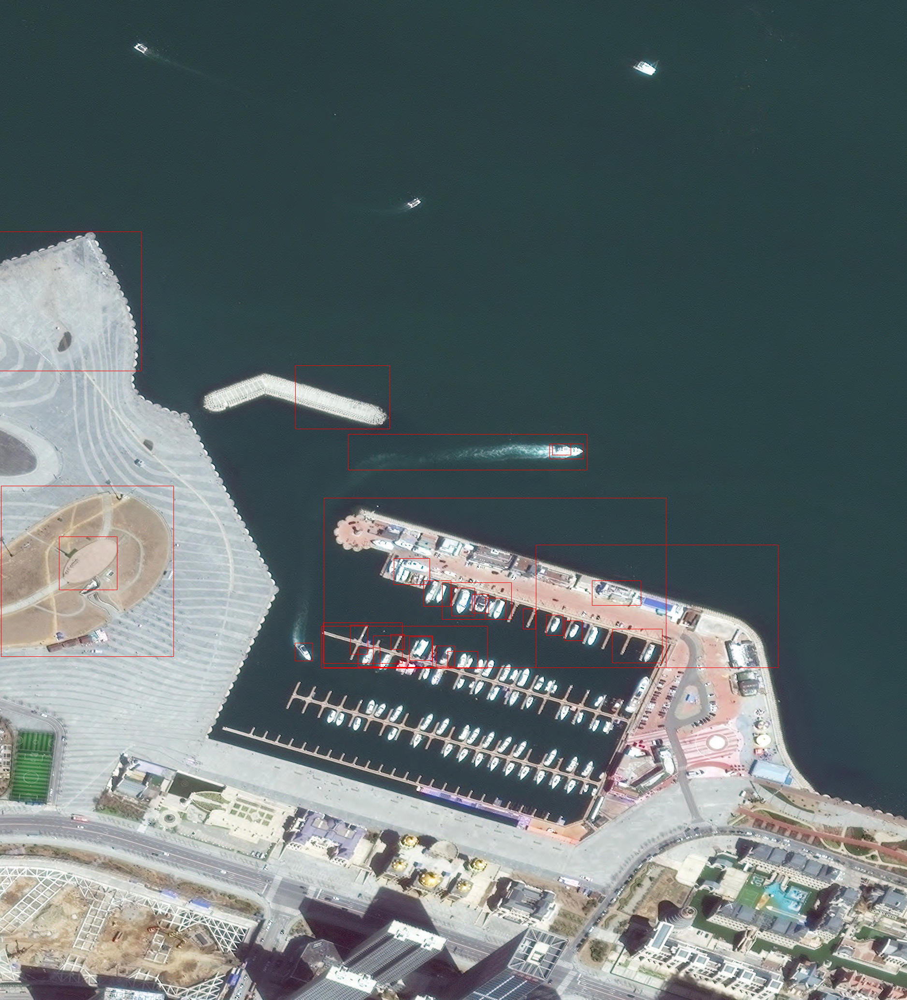

In [104]:
import PIL

image = Image.open(image_name)
draw = PIL.ImageDraw.Draw(image)
kept_boxes = stacked_boxes[kept]
for i in range(kept_boxes.shape[0]):
    box = kept_boxes[i]
    x1 = int(box[0])
    y1 = int(box[1])
    x2 = int(box[2])
    y2 = int(box[3])
    draw.rectangle((x1, y1, x2, y2), outline="red", width=1)
display(image)

In [105]:
ious = torchvision.ops.box_iou(kept_boxes, kept_boxes)
min = ious >= 0.2
used = set()
merged = []
for pair in min.nonzero():
    if (pair[0] == pair[1]):
        continue
    if pair[0].item() in used or pair[1].item() in used:
        continue
    used.add(pair[0].item())
    used.add(pair[1].item())
    b1 = kept_boxes[pair[0].item()]
    b2 = kept_boxes[pair[1].item()]
    stacked = torch.stack([b1, b2], 0)
    x1 = torch.min(stacked[:, 0])
    y1 = torch.min(stacked[:, 1])
    x2 = torch.max(stacked[:, 2])
    y2 = torch.max(stacked[:, 3])
    merged.append(torch.stack([x1, y1, x2, y2]))

for i in range(kept_boxes.shape[0]):
    if i not in used:
        merged.append(kept_boxes[i])

In [106]:
stacked_merged = torch.stack(merged)

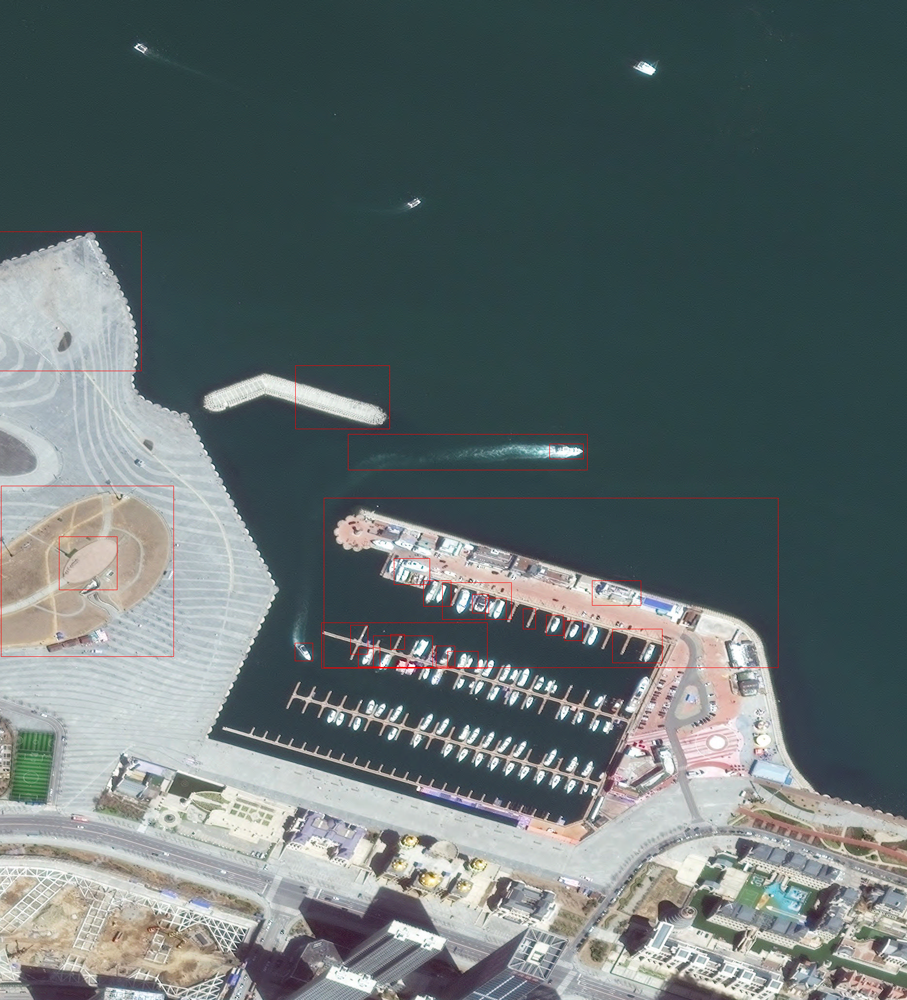

In [107]:
import PIL

image = Image.open(image_name)
draw = PIL.ImageDraw.Draw(image)
for i in range(stacked_merged.shape[0]):
    box = stacked_merged[i]
    x1 = int(box[0])
    y1 = int(box[1])
    x2 = int(box[2])
    y2 = int(box[3])
    draw.rectangle((x1, y1, x2, y2), outline="red", width=1)
display(image)

## Try Image Guided

In [128]:
query_image_name = 'images/single-ship.png'

query_image = Image.open(query_image_name)
query_image_arr = np.array(image)

In [131]:

print(query.keys())

dict_keys(['query_pixel_values'])


In [134]:
query_pixels = query['query_pixel_values']
print(query_pixels.repeat(5, 1, 1, 1).shape)

torch.Size([5, 3, 768, 768])


In [137]:
%%time

import tiling
import tqdm
import torch
from torchvision.transforms import v2

batch_size = 5

tiles = tiling.tile_image(image_arr, size, size, 0.2)
print('total tiles:', len(tiles))
height, width = tiles[0].tile.shape[:2]
results = []
cuda_image = torch.tensor(image_arr).to(device).detach()
cuda_image = cuda_image.permute(2, 0, 1)
batch_size = 5
tensors = [cuda_image[:, t.y:t.y + height, t.x:t.x + width] for t in tiles]
batches = [tensors[i:i + batch_size] for i in range(0, len(tensors), batch_size)]
query = processor(query_images=query_image_arr, return_tensors="pt").to(device)
query_batch = query['query_pixel_values'].repeat(batch_size, 1, 1, 1)
with torch.no_grad():
    model.to(device)
    for batch in tqdm.tqdm(batches):
        inputs = {}
        inputs['pixel_values'] = normalize(rescale(torch.stack(batch, 0)))
        inputs['query_pixel_values'] = query_batch[:len(batch)]
        sizes = torch.tensor([size, size]).to(device).repeat(len(batch), 1)
        results.extend(processor.post_process_image_guided_detection(model.image_guided_detection(**inputs), threshold=0.09, target_sizes=sizes))

total tiles: 12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:01<00:00,  2.47it/s]

CPU times: user 1.66 s, sys: 0 ns, total: 1.66 s
Wall time: 1.27 s


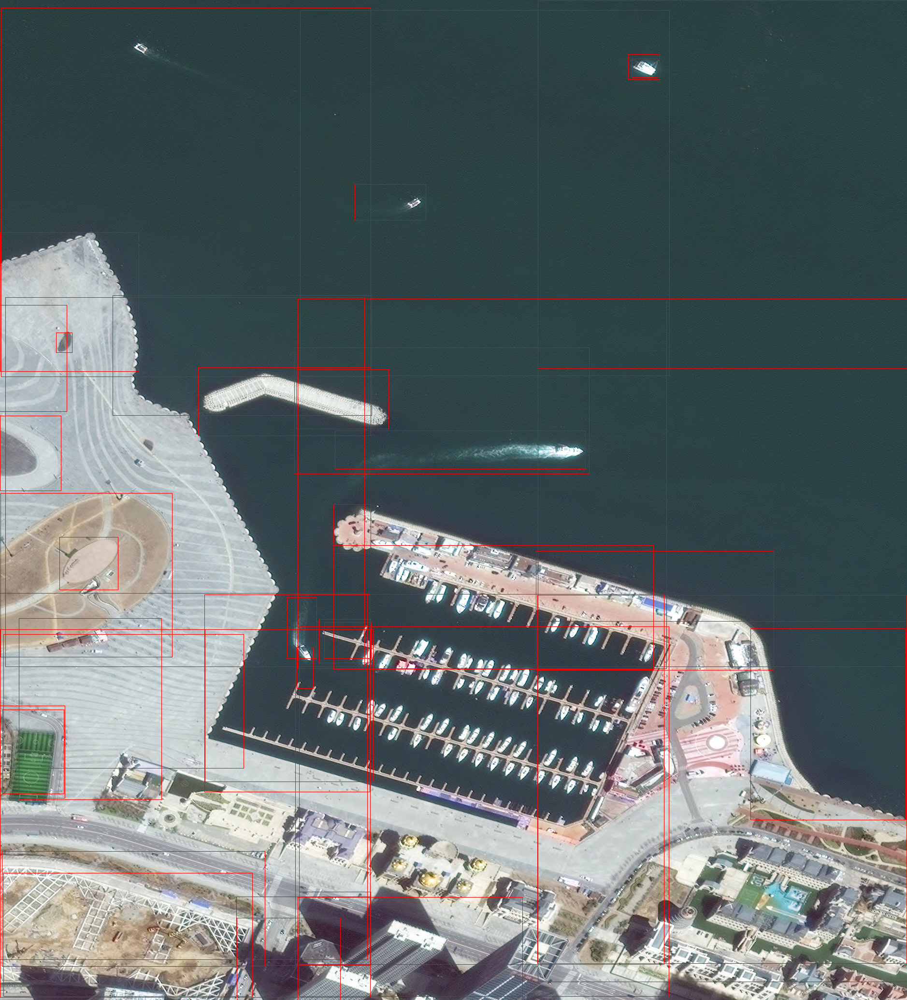

In [138]:
import PIL

image = Image.open(image_name)
draw = PIL.ImageDraw.Draw(image)
for tile, result in zip(tiles, results):
    boxes = result['boxes']
    for i in range(boxes.shape[0]):
        box = boxes[i]
        x1 = int(box[0] + tile.x)
        y1 = int(box[1] + tile.y)
        x2 = int(box[2] + tile.x)
        y2 = int(box[3] + tile.y)
        draw.rectangle((x1, y1, x2, y2), outline="red", width=1)
display(image)